<a href="https://colab.research.google.com/github/yuval105/data-science-project/blob/master/Arch_Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%cd /content/
# Clone the entire repo.
!git clone https://github.com/yuval105/data-science-project.git
%cd data-science-project
!git checkout master
!pip install "torch==1.4" "torchvision==0.5.0"

/content
fatal: destination path 'data-science-project' already exists and is not an empty directory.
/content/data-science-project
Already on 'master'
Your branch is up to date with 'origin/master'.
     |████████████████████████████████| 753.4MB 21kB/s 
     |████████████████████████████████| 4.0MB 29.4MB/s 
  Found existing installation: torch 1.5.0+cu101
    Uninstalling torch-1.5.0+cu101:
      Successfully uninstalled torch-1.5.0+cu101
  Found existing installation: torchvision 0.6.0+cu101
    Uninstalling torchvision-0.6.0+cu101:
      Successfully uninstalled torchvision-0.6.0+cu101


Download the exterior classifier data

In [ ]:
from utils.image_downloader import download_image_dataset
download_image_dataset('exterior_classifer/urls','exterior_classifer/images',24)

In [ ]:
from fastai.vision import *
tfms = get_transforms(do_flip=True)
data = ImageList.from_folder('exterior_classifer/images/').split_by_rand_pct(0.2).label_from_folder().transform(tfms, size=224).databunch(val_bs=128).normalize(imagenet_stats)

In [ ]:
from sklearn import svm
train_dl =data.dl(DatasetType.Train)
x,y = zip(*list(train_dl))
x = torch.cat(x).cpu().numpy()
y=  torch.cat(y).cpu().numpy()

KeyboardInterrupt: ignored

In [ ]:
x = x.reshape((x.shape[0],-1))
clf = svm.SVC()
clf.fit(x,y)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

In [ ]:
test_dl =data.dl(DatasetType.Valid)
x_test,y_test = zip(*list(test_dl))
x_test = torch.cat(x_test).cpu().numpy()
y_test=  torch.cat(y_test).cpu().numpy()

In [ ]:
from sklearn import metrics
x_test = x_test.reshape((x_test.shape[0],-1))
y_pred = clf.predict(x_test)
metrics.accuracy_score(y_pred,y_test)

0.8507936507936508

Run 10 epochs on the data with resnet18 backbone.

In [ ]:
learn = cnn_learner(data, models.resnet18, metrics=accuracy,pretrained=False)
learn.fit(10,1e-2)

epoch,train_loss,valid_loss,accuracy,time
0,1.062560,616.081177,0.546032,00:22
1,0.746201,4.175162,0.679365,00:17
2,0.623476,0.816746,0.688889,00:17
3,0.536707,0.398820,0.857143,00:16
4,0.510240,0.441555,0.819048,00:16
5,0.516584,0.500042,0.758730,00:17
6,0.495170,0.454721,0.790476,00:17
7,0.456311,0.335765,0.853968,00:16
8,0.429748,0.256530,0.888889,00:17
9,0.410596,0.238904,0.901587,00:16


Lets ee the results on the validataion test

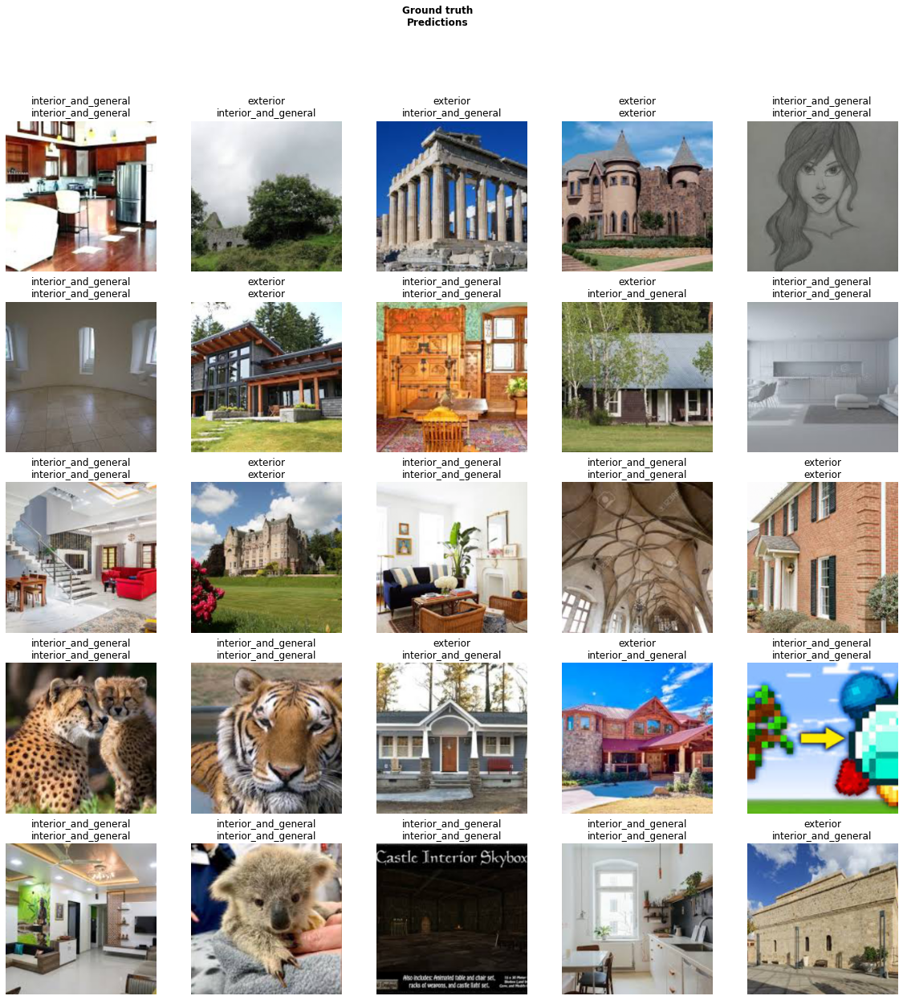

In [ ]:
learn.show_results(DatasetType.Valid)

Now we will test the model on the arch urls dataset

In [ ]:
download_image_dataset('data/urls','data/images',24)

Let the model predict on the test dataset

In [ ]:
data_archs = ImageList.from_folder('data/images/')
learn.data.add_test(data_archs)

In [ ]:
preds = learn.get_preds(DatasetType.Test)

Plot some mixed results

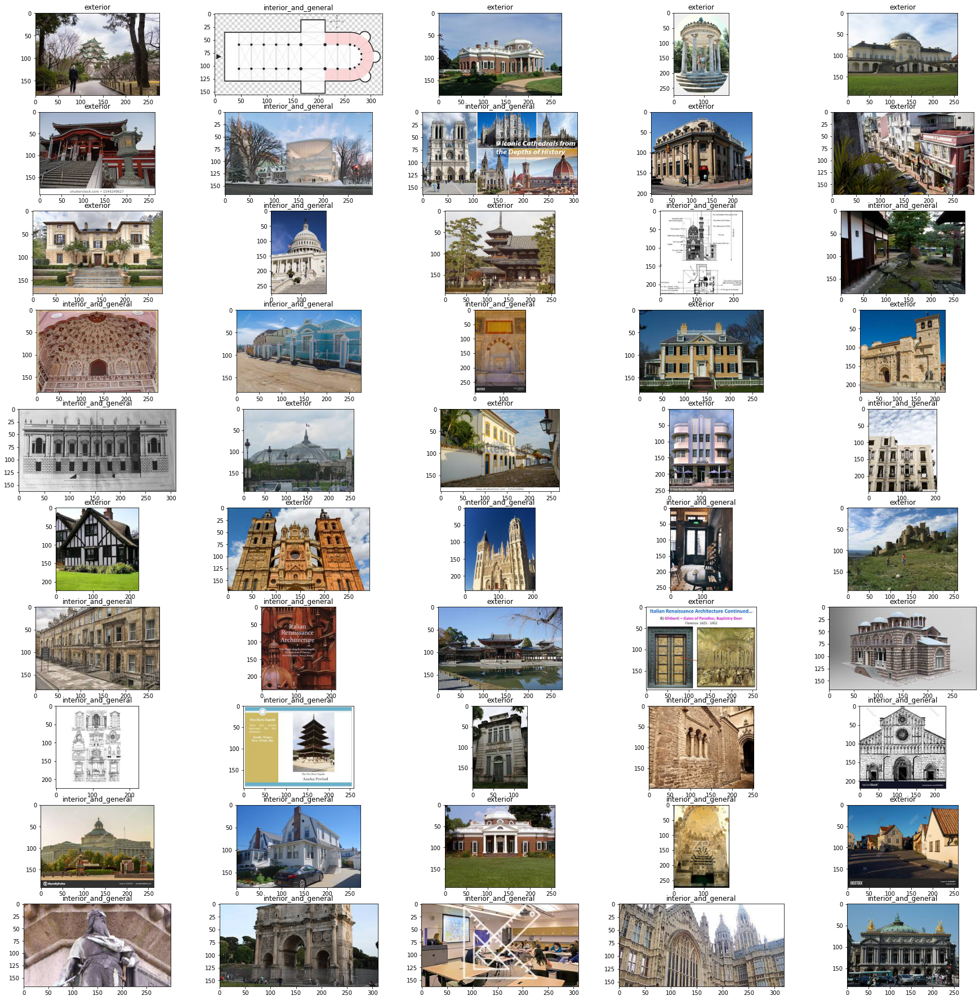

In [ ]:
import matplotlib.pyplot as plt
import random

rows,cols = 10,5

fig,axes = plt.subplots(rows,cols,figsize=(8,8))

plt.subplots_adjust(0,0,3,3)

for i in range(rows):
  for j in range(cols):
    image_idx = random.randint(0,len(data_archs))
    label = preds[0][image_idx].argmax()
    axes[i,j].imshow(data_archs[image_idx].data.permute(1,2,0))
    axes[i,j].set_title(data.classes[label])

Plot only interior results

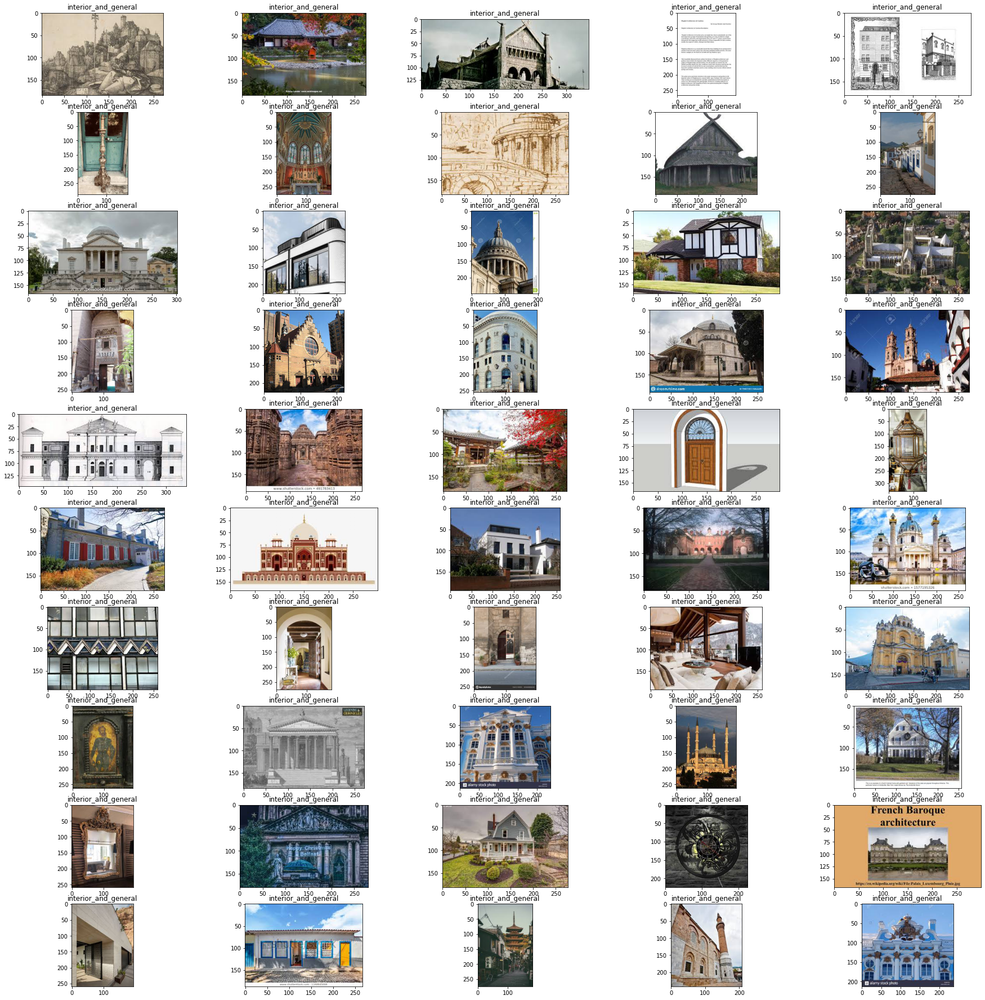

In [ ]:
interior = preds[0].argmax(dim=1).nonzero()
rows,cols = 10,5

fig,axes = plt.subplots(rows,cols,figsize=(8,8))

plt.subplots_adjust(0,0,3,3)

for i in range(rows):
  for j in range(cols):
    image_idx = interior[random.randint(0,interior.shape[0])].item()
    label = preds[0][image_idx].argmax()
    axes[i,j].imshow(data_archs[image_idx].data.permute(1,2,0))
    axes[i,j].set_title(data.classes[label])

Plot only Exterior results

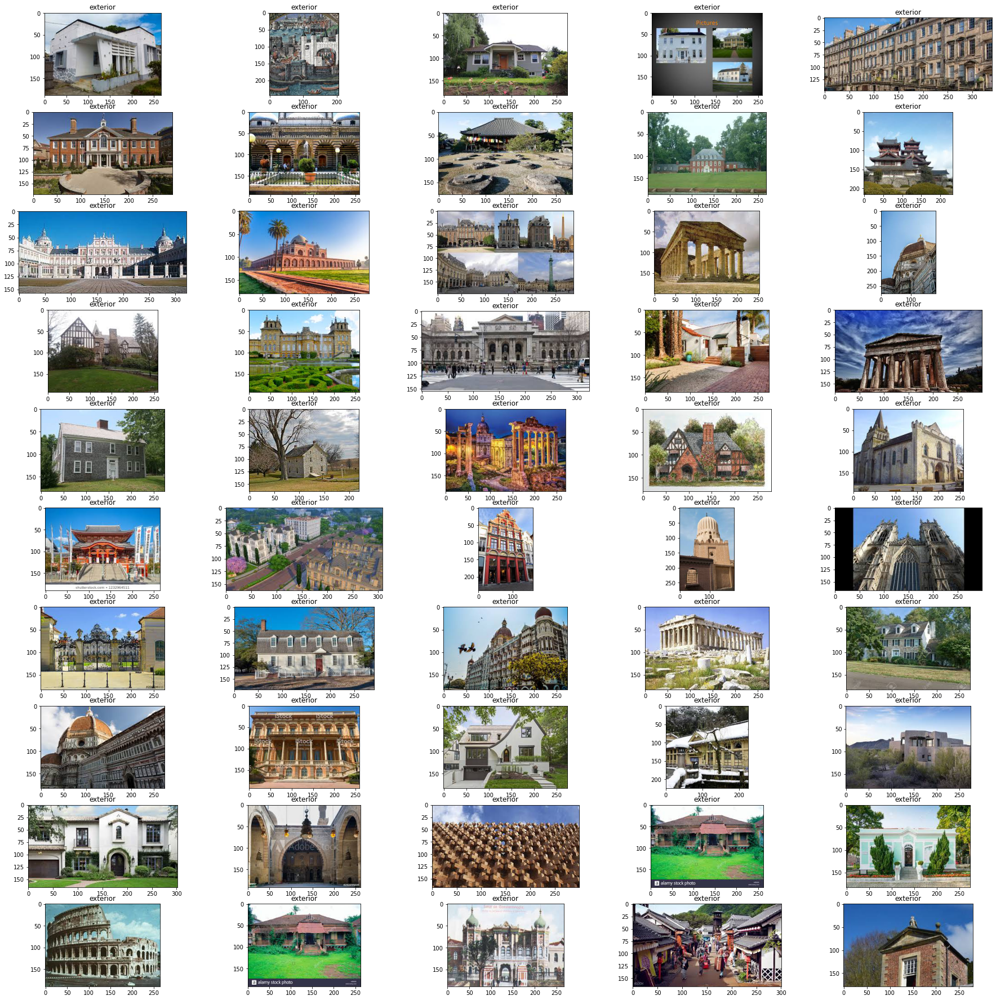

In [ ]:
exterior = (preds[0].argmax(dim=1)==0).nonzero()
rows,cols = 10,5

fig,axes = plt.subplots(rows,cols,figsize=(8,8))

plt.subplots_adjust(0,0,3,3)

for i in range(rows):
  for j in range(cols):
    image_idx = exterior[random.randint(0,exterior.shape[0])].item()
    label = preds[0][image_idx].argmax()
    axes[i,j].imshow(data_archs[image_idx].data.permute(1,2,0))
    axes[i,j].set_title(data.classes[label])

In [ ]:
real_data_archs = data_archs[exterior.squeeze()]
real_data_archs.split_none().label_from_folder().train.to_csv('cleaned.csv')

In [ ]:
real_data_archs = ImageList.from_csv('data/images','cleaned.csv')
real_data_archs

ImageList (3730 items)
Image (3, 194, 259),Image (3, 183, 275),Image (3, 189, 267),Image (3, 168, 299),Image (3, 184, 273)
Path: data/images

In [ ]:
import os 
def label_from_first_class_folder(path):
  return (path.relative_to('data/images').parts if isinstance(path,Path) else os.path.relpath(path,'data/images').split(os.path.sep))[0]

tfms = get_transforms(do_flip=True)
databunch_archs = real_data_archs.split_by_rand_pct(0.2).label_from_func(label_from_first_class_folder).transform(tfms,size=224).databunch().normalize(imagenet_stats)

NameError: ignored

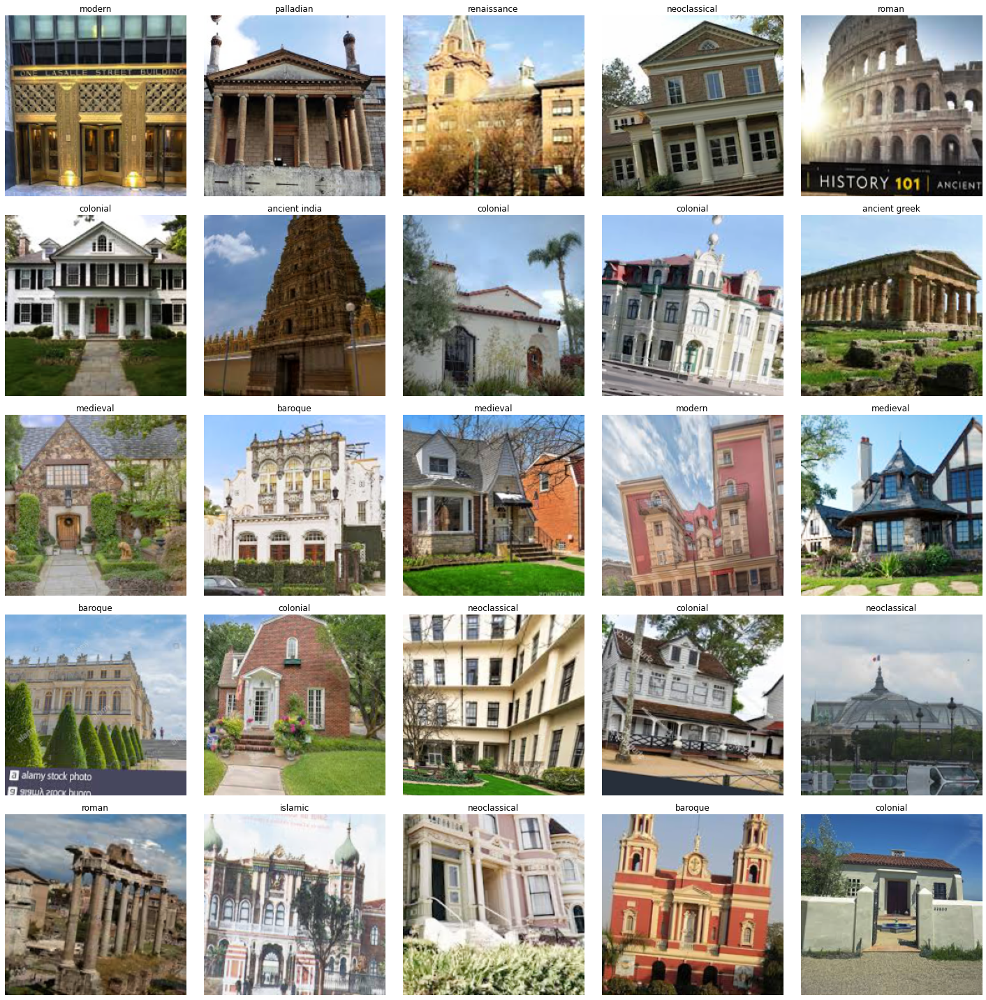

In [ ]:
databunch_archs.show_batch()

In [ ]:
learn_archs = cnn_learner(databunch_archs,models.resnet50,metrics=[accuracy],pretrained=False)

In [ ]:
learn_archs.fit(100,1e-3)

epoch,train_loss,valid_loss,accuracy,time
0,3.321880,2.791596,0.206434,01:12
1,3.073210,2.386846,0.246649,01:07
2,2.897435,2.256170,0.285523,01:07
3,2.707904,2.254386,0.286863,01:07
4,2.593239,2.176845,0.306971,01:07


KeyboardInterrupt: ignored

In [ ]:
interp = learn_archs.interpret(DatasetType.Valid)


In [ ]:
interp.plot_confusion_matrix(figsize=(10,10))

In [ ]:
interp.plot_top_losses(16,figsize=(20,20))

In [ ]:
learn_archs.export()

In [ ]:
from utils.image_downloader import download_wiki_images
df=download_wiki_images('data/wikipedia/wiki.csv','data/wikipedia/images',max_rows = 18000,max_workers=30)
df

,year,link,title,thumbnails,images,lat,lng,loc_score,style,known_style,Unnamed: 10,Unnamed: 11,image_path
0,914,/wiki/Alc%C3%A1zar_of_Seville,Alcázar of Seville,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:Sevilla-2-2_(48040287512).jpg, /wi...",37.383890,-5.991390,100.00,NaN,NaN,NaN,NaN,File:Sevilla-2-2_(48040287512).jpg
1,944,/wiki/Al-Askari_Shrine,Al-Askari Shrine,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:Al-Asakari_Mosque_4.jpg, /wiki/Fil...",34.199040,43.873530,100.00,NaN,NaN,NaN,NaN,File:Al-Asakari_Mosque_4.jpg
2,970,"/wiki/All_Saints%27_Church,_Earls_Barton","All Saints' Church, Earls Barton",['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:EarlsBartonChurch.JPG, /wiki/File:...",52.265270,-0.752590,95.50,Anglo-Saxon,NaN,NaN,NaN,File:EarlsBartonChurch.JPG
3,977,/wiki/Imam_Ali_Mosque,Imam Ali Mosque,['//upload.wikimedia.org/wikipedia/commons/thu...,[/wiki/File:Imam_Ali_Mosque_by_tasnimnews.com0...,31.995887,44.314225,100.00,NaN,NaN,NaN,NaN,File:Imam_Ali_Mosque_by_tasnimnews.com09.jpg
4,1001,/wiki/Cathedral_of_Ani,Cathedral of Ani,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:Ani-Cathedral,_Ruine.jpeg, /wiki/F...",25.652120,94.106980,96.43,Armenian,NaN,NaN,NaN,"File:Ani-Cathedral,_Ruine.jpeg"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15046,1848,/wiki/Seven_Oaks_Farm_and_Black%27s_Tavern,Seven Oaks Farm and Black's Tavern,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:Seven_Oaks_Farm_barn.jpg, /wiki/Fi...",51.270200,0.192960,73.00,NaN,NaN,NaN,NaN,File:Sibley_House_Detroit_MI.jpg
15047,1848,/wiki/Charles_L._Shrewsbury_House,Charles L. Shrewsbury House,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:Shrewsbury-Windle_House,_Madison,_...",42.280088,-71.742798,84.63,NaN,NaN,NaN,NaN,"File:JACOB_SLOAT_HOUSE,_AKA_HARMONY_HALL,_ROCK..."
15048,1848,/wiki/Dr._Henry_Spence_Cobblestone_Farmhouse_a...,Dr. Henry Spence Cobblestone Farmhouse and Bar...,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:USA_New_York_location_map.svg, /wi...",38.420400,-77.395800,71.65,NaN,NaN,NaN,NaN,File:Stapeley_House_2.jpg
15049,1848,/wiki/Spring_Side,Spring Side,['//upload.wikimedia.org/wikipedia/commons/thu...,"[/wiki/File:USA_Iowa_location_map.svg, /wiki/F...",35.631410,-120.691770,100.00,NaN,NaN,NaN,NaN,File:DR._B_STAUFFER_HOUSE.jpg


In [ ]:
wiki_data = ImageList.from_df(df,path='data/wikipedia/images',cols='image_path')
learn.data.add_test(wiki_data)

In [ ]:
preds = learn.get_preds(DatasetType.Test)

OSError: ignored

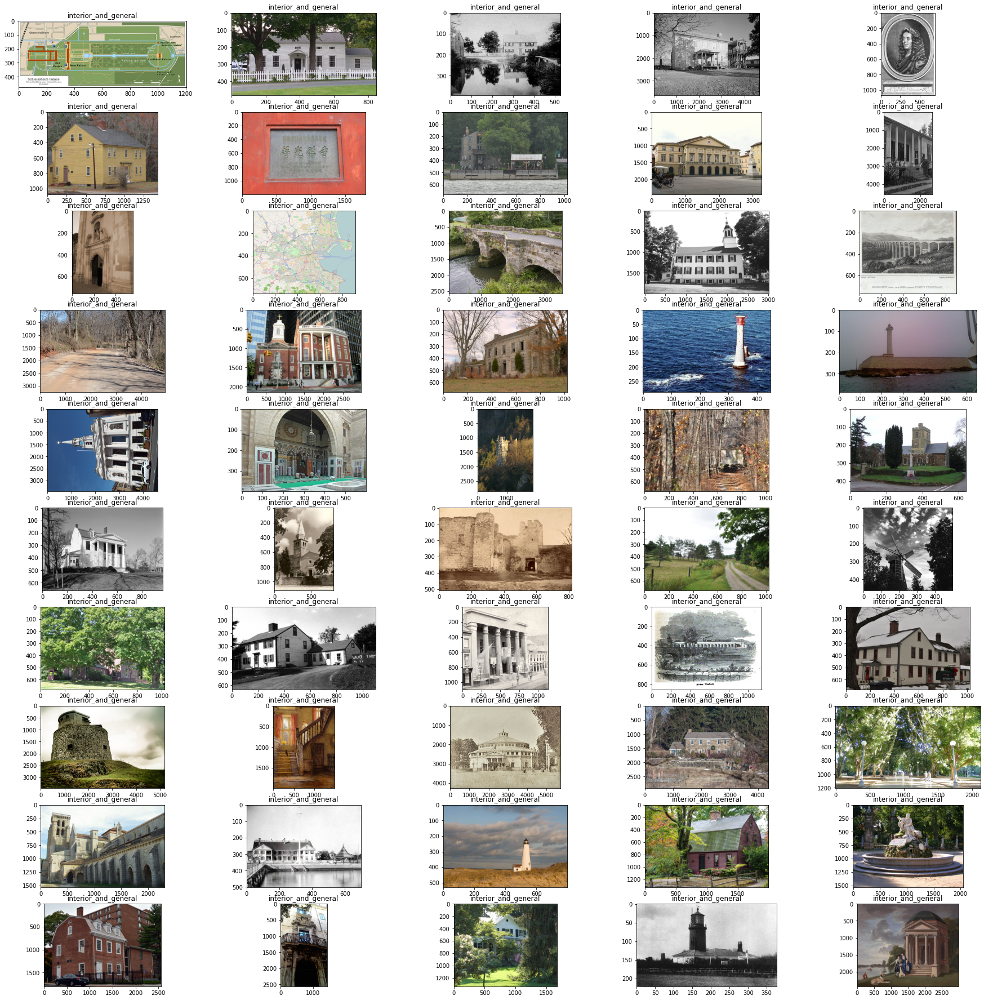

In [ ]:
exterior = (preds[0].argmax(dim=1)==0).nonzero()
interior = preds[0].argmax(dim=1).nonzero()
rows,cols = 10,5

fig,axes = plt.subplots(rows,cols,figsize=(8,8))

plt.subplots_adjust(0,0,3,3)

for i in range(rows):
  for j in range(cols):
    image_idx = interior[random.randint(0,interior.shape[0])].item()
    label = preds[0][image_idx].argmax()
    axes[i,j].imshow(wiki_data[image_idx].data.permute(1,2,0))
    axes[i,j].set_title(data.classes[label])

In [ ]:
wiki_data = wiki_data[exterior.squeeze()]
wiki_data

ImageList (8334 items)
Image (3, 3427, 4569),Image (3, 557, 800),Image (3, 3456, 2304),Image (3, 1200, 1600),Image (3, 3648, 2736)
Path: data/wikipedia/images